In [336]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

In [337]:
import random as rn
from pprint import pprint as pp
import string

STUID = 993212018  # Your Student ID


def qdata(stuID, num=10):
    rn.seed(stuID)

    datasets = list(string.ascii_lowercase[1:24])
    rn.shuffle(datasets)
    return datasets[:num]


pp(qdata(STUID))
exclusive_features = qdata(STUID)


['k', 's', 'd', 't', 'o', 'h', 'f', 'p', 'c', 'e']


In [338]:
flight_satisfaction = pd.read_csv("flight_satisfaction.csv")

# Map columns to alphabets from A to Z
alphabet_mapping = {col: chr(ord('A') + idx) for idx, col in enumerate(flight_satisfaction.columns)}

# Columns to keep based on the specified alphabets
selected_alphabets = exclusive_features
selected_columns = [col for col, alphabet in alphabet_mapping.items() if alphabet.lower() in selected_alphabets]
selected_columns.append('satisfaction')
print(selected_columns)

# Create the new dataset
flight_satisfaction = flight_satisfaction[selected_columns] 


print(flight_satisfaction)


['Gender', 'Customer Type', 'Age', 'Type of Travel', 'Flight Distance', 'Ease of Online booking', 'Seat comfort', 'Inflight entertainment', 'Baggage handling', 'Checkin service', 'satisfaction']
        Gender      Customer Type  Age   Type of Travel  Flight Distance  \
0         Male     Loyal Customer   13  Personal Travel              460   
1         Male  disloyal Customer   25  Business travel              235   
2       Female     Loyal Customer   26  Business travel             1142   
3       Female     Loyal Customer   25  Business travel              562   
4         Male     Loyal Customer   61  Business travel              214   
...        ...                ...  ...              ...              ...   
103899  Female  disloyal Customer   23  Business travel              192   
103900    Male     Loyal Customer   49  Business travel             2347   
103901    Male  disloyal Customer   30  Business travel             1995   
103902  Female  disloyal Customer   22  Busin

In [339]:
flight_satisfaction.sample(6)

,Gender,Customer Type,Age,Type of Travel,Flight Distance,Ease of Online booking,Seat comfort,Inflight entertainment,Baggage handling,Checkin service,satisfaction
8456,Male,Loyal Customer,11,Personal Travel,1121,3,1,1,1,4,neutral or dissatisfied
78245,Male,Loyal Customer,7,Personal Travel,1073,1,4,4,5,3,neutral or dissatisfied
49833,Male,Loyal Customer,50,Business travel,1269,3,2,2,4,2,neutral or dissatisfied
54944,Female,Loyal Customer,49,Business travel,1659,4,4,3,3,5,satisfied
76343,Female,Loyal Customer,60,Business travel,3914,3,5,5,5,3,satisfied
91452,Female,Loyal Customer,59,Business travel,1598,2,3,3,3,4,neutral or dissatisfied


Let's see how many missing values we have in each column. 

In [340]:
# get the number of missing data points per column
missing_values_count = flight_satisfaction.isnull().sum()

missing_values_count

Gender                    0
Customer Type             0
Age                       0
Type of Travel            0
Flight Distance           0
Ease of Online booking    0
Seat comfort              0
Inflight entertainment    0
Baggage handling          0
Checkin service           0
satisfaction              0
dtype: int64

In [341]:
#total_cells = np.product(flight_satisfaction.shape)
#total_missing = missing_values_count.sum()

## percent of data that is missing
#(total_missing/total_cells) * 100

# Figure out why the data is missing

In [342]:
# look at the # of missing points in the first ten columns
missing_values_count

Gender                    0
Customer Type             0
Age                       0
Type of Travel            0
Flight Distance           0
Ease of Online booking    0
Seat comfort              0
Inflight entertainment    0
Baggage handling          0
Checkin service           0
satisfaction              0
dtype: int64

These missing values are probably missing because they were not recorded, rather than because they don't exist. So, it would make sense for us to try and guess what they should be rather than just leaving them as NA's.

# Drop missing values

drop rows with missing values = `dropna()`


In [343]:
# remove all the rows that contain a missing value
#flight_satisfaction.dropna()

It's better to remove all the *columns* that have at least one missing value instead.

In [344]:
# remove all columns with at least one missing value
#columns_with_na_dropped = flight_satisfaction.dropna(axis=1)
#columns_with_na_dropped

In [345]:
## just how much data did we lose?
#print("Columns in original dataset: %d \n" % flight_satisfaction.shape[1])
#print("Columns with na's dropped: %d" % columns_with_na_dropped.shape[1])

We've lost quite a bit of data, but at this point we have successfully removed all the `NaN`'s from our data.

# Filling in missing values automatically

Another option is to try and fill in the missing values. For this next bit, I'm getting a small sub-section of the data so that it will print well.

In [346]:
# replace all NA's with 0
#flight_satisfaction.fillna(0)

I could also be a bit more savvy and replace missing values with whatever value comes directly after it in the same column. (This makes a lot of sense for datasets where the observations have some sort of logical order to them.)

In [347]:
# replace all NA's the value that comes directly after it in the same column, 
# then replace all the reamining na's with 0
#flight_satisfaction.fillna(method = 'bfill', axis=0).fillna(0)

# Handling duplicate data

In [348]:
flight_satisfaction = flight_satisfaction.drop_duplicates()

# Identifying outliers with visualization
what's an outlier?it's a data point that's very far from the other data points. Mathematically, an outlier is usually defined as an observation more than three standard deviations from the mean (although sometimes you'll see 2.5 or 2 as well).
> **Z-score**: The number of standard deviations away from the mean that a particular observation is. (You can see the mathematical definition [here](http://mathworld.wolfram.com/z-Score.html), if you're curious.) A negative Z-score means an observation is below the mean, while a positive one means it above it. The further away from 0 the Z-Score is, the further away from the mean your observation is. 

One of the easiest ways to see if your dataset has outliers is to plot your data. The type of plot you pick will depend on how many and what kind of variable you're interesting in looking at. Today, we're going to look at three different plots.

## Age

<Axes: xlabel='Age', ylabel='Count'>

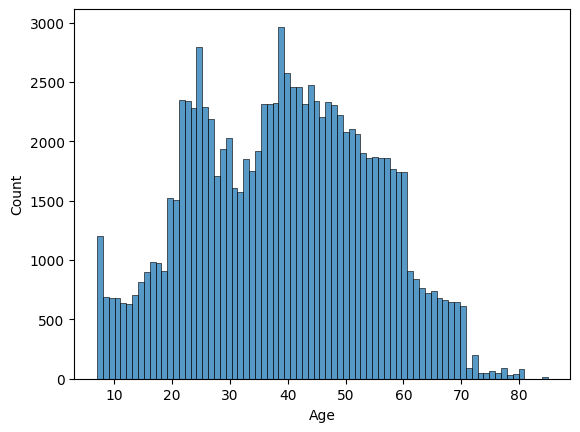

In [349]:
sns.histplot(flight_satisfaction['Age'])

In [350]:
fig = px.histogram(flight_satisfaction, x='Age')
fig.show()

<Axes: >

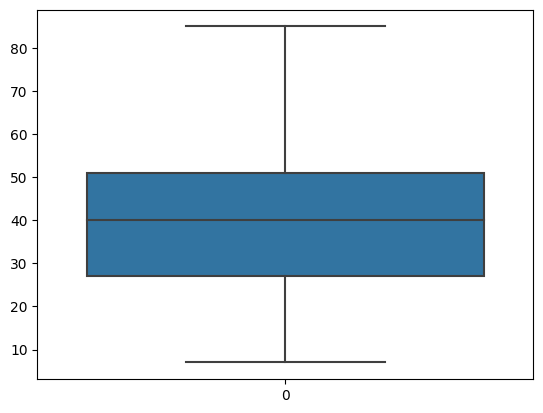

In [351]:
sns.boxplot(flight_satisfaction['Age'])

In [352]:
# Scatter plot
fig = px.scatter(x=flight_satisfaction['Age'])
fig.show()

# Z-score method

In [353]:
# find the limits
upper_limit_age_1 = flight_satisfaction['Age'].mean() + 3*flight_satisfaction['Age'].std()
lower_limit_age_1 = flight_satisfaction['Age'].mean() - 3*flight_satisfaction['Age'].std()
print('upper limit:', upper_limit_age_1)
print('lower limit:', lower_limit_age_1)

upper limit: 84.7242343561859
lower limit: -5.969951613304545


In [354]:
# find the outliers
flight_satisfaction.loc[(flight_satisfaction['Age'] > upper_limit_age_1) | (flight_satisfaction['Age'] < lower_limit_age_1)]

,Gender,Customer Type,Age,Type of Travel,Flight Distance,Ease of Online booking,Seat comfort,Inflight entertainment,Baggage handling,Checkin service,satisfaction
2023,Male,Loyal Customer,85,Business travel,1904,2,3,1,3,3,neutral or dissatisfied
19187,Male,Loyal Customer,85,Business travel,3732,4,3,3,3,3,neutral or dissatisfied
28863,Male,Loyal Customer,85,Business travel,2078,5,4,3,5,4,satisfied
30723,Female,disloyal Customer,85,Business travel,617,3,1,3,3,1,neutral or dissatisfied
31868,Female,Loyal Customer,85,Business travel,147,4,4,2,4,4,neutral or dissatisfied
35919,Female,Loyal Customer,85,Business travel,3156,5,3,3,4,3,neutral or dissatisfied
37138,Female,Loyal Customer,85,Business travel,187,3,4,3,4,4,neutral or dissatisfied
37790,Female,disloyal Customer,85,Business travel,899,2,3,2,4,3,neutral or dissatisfied
44343,Female,disloyal Customer,85,Business travel,586,2,5,2,1,5,neutral or dissatisfied
47096,Female,disloyal Customer,85,Business travel,366,3,3,3,2,3,neutral or dissatisfied


In [355]:
# trimming - delete the oulier data
new_dataset_age = flight_satisfaction.loc[(flight_satisfaction['Age'] < upper_limit_age_1) & (flight_satisfaction['Age'] > lower_limit_age_1)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_age))
print('outliers :', len(flight_satisfaction)-len(new_dataset_age))

before removing outliers : 103847
after removing outliers : 103830
outliers : 17


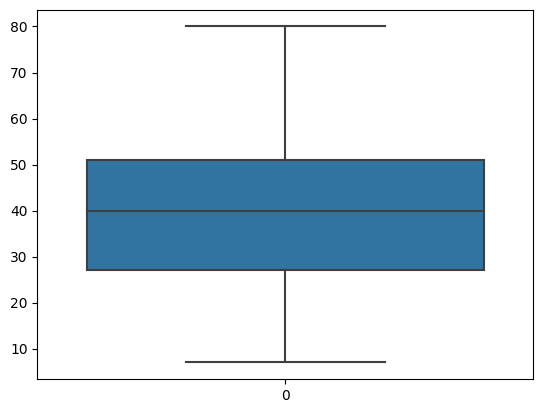

In [356]:
# Histogram
fig = px.histogram(new_dataset_age, x='Age')
fig.show()
# Box plot
sns.boxplot(new_dataset_age['Age'])
# Scatter plot
fig = px.scatter(x=new_dataset_age['Age'])
fig.show()

# IQR method

In [357]:
q1 = flight_satisfaction['Age'].quantile(0.25)
q3 = flight_satisfaction['Age'].quantile(0.75)
iqr = q3-q1
q1, q3, iqr

(27.0, 51.0, 24.0)

In [358]:
upper_limit_age_2 = q3 + (1.5*iqr)
lower_limit_age_2 = q1 - (1.5*iqr)
lower_limit_age_2, upper_limit_age_2

(-9.0, 87.0)

In [359]:
# trimming - delete the oulier data
new_dataset_age_2 = flight_satisfaction.loc[(flight_satisfaction['Age'] < upper_limit_age_2) & (flight_satisfaction['Age'] > lower_limit_age_2)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_age_2))
print('outliers :', len(flight_satisfaction)-len(new_dataset_age_2))

before removing outliers : 103847
after removing outliers : 103847
outliers : 0


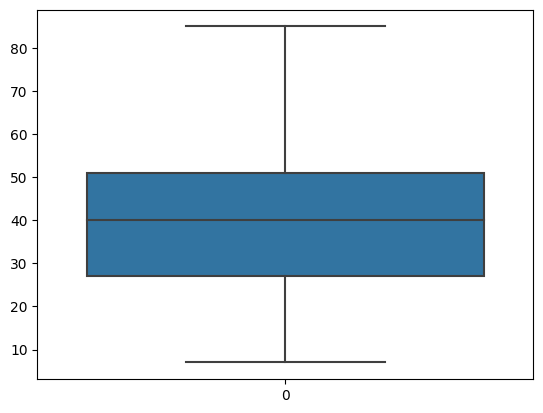

In [360]:
# Histogram
fig = px.histogram(new_dataset_age_2, x='Age')
fig.show()
# Box plot
sns.boxplot(new_dataset_age_2['Age'])
# Scatter plot
fig = px.scatter(x=new_dataset_age_2['Age'])
fig.show()

# percentile method

In [361]:
upper_limit_age_3 = flight_satisfaction['Age'].quantile(0.99)
lower_limit_age_3 = flight_satisfaction['Age'].quantile(0.01)
print('upper_limit', upper_limit_age_3)
print('lower_limit', lower_limit_age_3)

upper_limit 70.0
lower_limit 8.0


In [362]:
# find the outliers
flight_satisfaction.loc[(flight_satisfaction['Age'] > upper_limit_age_3) | (flight_satisfaction['Age'] < lower_limit_age_3)]

,Gender,Customer Type,Age,Type of Travel,Flight Distance,Ease of Online booking,Seat comfort,Inflight entertainment,Baggage handling,Checkin service,satisfaction
252,Male,Loyal Customer,72,Business travel,305,3,4,4,3,1,neutral or dissatisfied
258,Female,Loyal Customer,72,Business travel,67,3,4,3,3,4,neutral or dissatisfied
337,Female,Loyal Customer,72,Business travel,1870,1,4,2,2,1,neutral or dissatisfied
401,Male,Loyal Customer,7,Personal Travel,405,3,4,4,4,3,neutral or dissatisfied
502,Male,Loyal Customer,7,Personal Travel,1034,2,4,5,3,4,neutral or dissatisfied
...,...,...,...,...,...,...,...,...,...,...,...
103591,Female,Loyal Customer,7,Personal Travel,349,4,2,2,5,5,neutral or dissatisfied
103606,Male,disloyal Customer,72,Business travel,1999,5,3,3,4,3,satisfied
103845,Male,Loyal Customer,77,Business travel,867,3,3,3,4,1,neutral or dissatisfied
103855,Male,Loyal Customer,72,Business travel,1621,2,2,3,3,3,neutral or dissatisfied


In [363]:
# trimming - delete the oulier data
new_dataset_age_3 = flight_satisfaction.loc[(flight_satisfaction['Age'] < upper_limit_age_3) & (flight_satisfaction['Age'] > lower_limit_age_3)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_age_3))
print('outliers :', len(flight_satisfaction)-len(new_dataset_age_3))

before removing outliers : 103847
after removing outliers : 101274
outliers : 2573


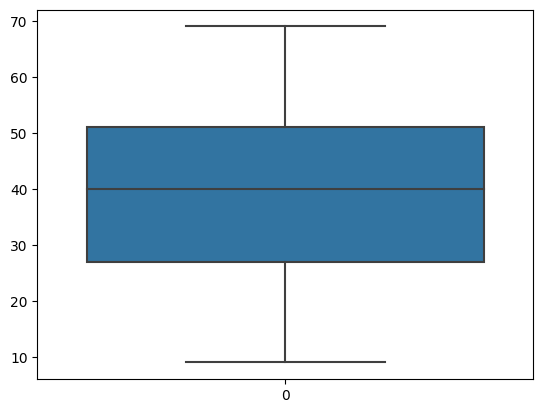

In [364]:
# Histogram
fig = px.histogram(new_dataset_age_3, x='Age')
fig.show()
# Box plot
sns.boxplot(new_dataset_age_3['Age'])
# Scatter plot
fig = px.scatter(x=new_dataset_age_3['Age'])
fig.show()

## Flight Distance

<Axes: xlabel='Flight Distance', ylabel='Count'>

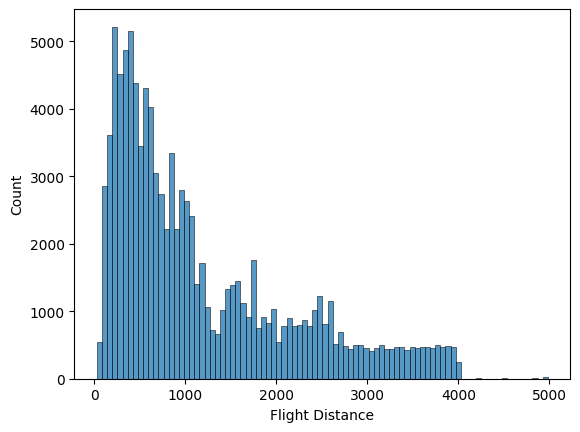

In [365]:
# Histogram
sns.histplot(flight_satisfaction['Flight Distance'])

In [366]:
# Histogram
fig = px.histogram(flight_satisfaction, x='Flight Distance')
fig.show()

<Axes: >

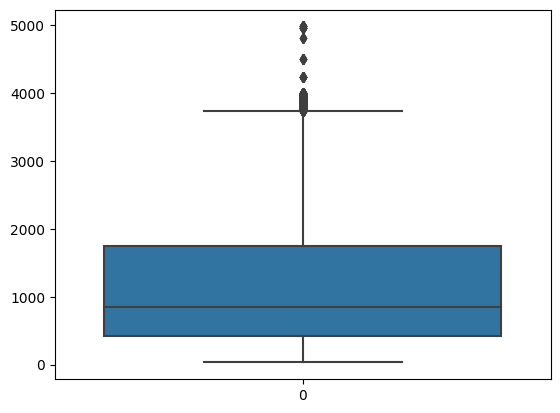

In [367]:
# Box plot
sns.boxplot(flight_satisfaction['Flight Distance'])

In [368]:
# Scatter plot
fig = px.scatter(x=flight_satisfaction['Flight Distance'])
fig.show()

# Z-score method

In [369]:
# find the limits
upper_limit_flight_distance_1 = new_dataset_age['Flight Distance'].mean() + 3*new_dataset_age['Flight Distance'].std()
lower_limit_flight_distance_1 = new_dataset_age['Flight Distance'].mean() - 3*new_dataset_age['Flight Distance'].std()
print('upper limit:', upper_limit_flight_distance_1)
print('lower limit:', lower_limit_flight_distance_1)

upper limit: 4181.278667919172
lower limit: -1802.1285571612025


In [370]:
# find the outliers
new_dataset_age.loc[(flight_satisfaction['Flight Distance'] > upper_limit_flight_distance_1) | (flight_satisfaction['Flight Distance'] < lower_limit_flight_distance_1)].head(5)

,Gender,Customer Type,Age,Type of Travel,Flight Distance,Ease of Online booking,Seat comfort,Inflight entertainment,Baggage handling,Checkin service,satisfaction
994,Female,Loyal Customer,26,Business travel,4243,2,4,3,4,4,satisfied
2401,Female,Loyal Customer,25,Personal Travel,4963,2,2,5,4,2,neutral or dissatisfied
2847,Female,Loyal Customer,63,Personal Travel,4983,0,1,3,3,1,satisfied
5903,Female,Loyal Customer,25,Business travel,4243,3,4,3,4,4,neutral or dissatisfied
11306,Male,disloyal Customer,22,Business travel,4243,5,5,5,5,5,satisfied


In [371]:
# trimming - delete the oulier data
#flight_satisfaction = flight_satisfaction.loc[(flight_satisfaction['Flight Distance'] < upper_limit_flight_distance_1) & (flight_satisfaction['Flight Distance'] > lower_limit_flight_distance_1)]
new_dataset_flight_distance = new_dataset_age.loc[(flight_satisfaction['Flight Distance'] < upper_limit_flight_distance_1) & (flight_satisfaction['Flight Distance'] > lower_limit_flight_distance_1)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_flight_distance))
print('outliers :', len(flight_satisfaction)-len(new_dataset_flight_distance))

before removing outliers : 103847
after removing outliers : 103772
outliers : 75


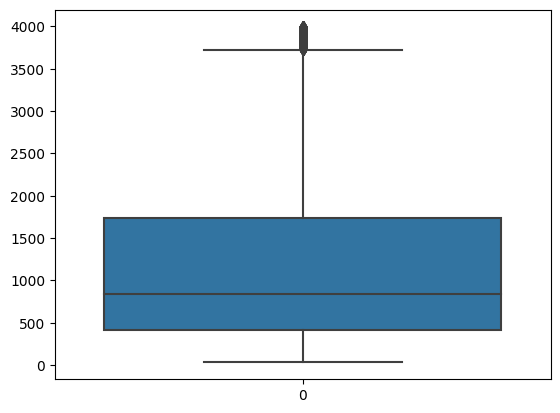

In [372]:
# Histogram
fig = px.histogram(new_dataset_flight_distance, x='Flight Distance')
fig.show()
# Box plot
sns.boxplot(new_dataset_flight_distance['Flight Distance'])
# Scatter plot
fig = px.scatter(x=new_dataset_flight_distance['Flight Distance'])
fig.show()

# IQR method

In [373]:
q1 = flight_satisfaction['Flight Distance'].quantile(0.25)
q3 = flight_satisfaction['Flight Distance'].quantile(0.75)
iqr = q3-q1
q1, q3, iqr

(414.0, 1743.0, 1329.0)

In [374]:
upper_limit_flight_distance_2 = q3 + (1.5*iqr)
lower_limit_flight_distance_2 = q1 - (1.5*iqr)
lower_limit_flight_distance_2, upper_limit_flight_distance_2

(-1579.5, 3736.5)

In [375]:
# trimming - delete the oulier data
new_dataset_flight_distance_2 = flight_satisfaction.loc[(flight_satisfaction['Flight Distance'] < upper_limit_flight_distance_2) & (flight_satisfaction['Flight Distance'] > lower_limit_flight_distance_2)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_flight_distance_2))
print('outliers :', len(flight_satisfaction)-len(new_dataset_flight_distance_2))

before removing outliers : 103847
after removing outliers : 101557
outliers : 2290


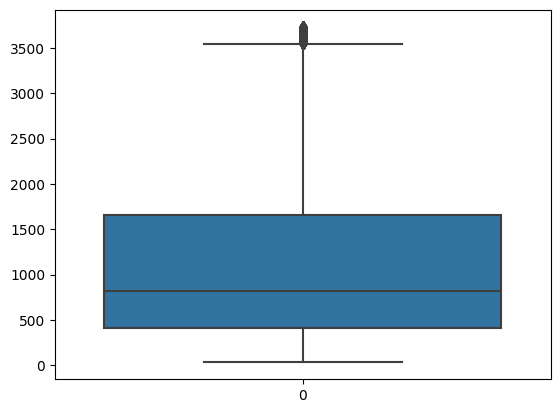

In [376]:
# Histogram
fig = px.histogram(new_dataset_flight_distance_2, x='Flight Distance')
fig.show()
# Box plot
sns.boxplot(new_dataset_flight_distance_2['Flight Distance'])
# Scatter plot
fig = px.scatter(x=new_dataset_flight_distance_2['Flight Distance'])
fig.show()

# percentile method

In [377]:
upper_limit_flight_distance_3 = flight_satisfaction['Flight Distance'].quantile(0.99)
lower_limit_flight_distance_3 = flight_satisfaction['Flight Distance'].quantile(0.01)
print('upper_limit', upper_limit_flight_distance_3)
print('lower_limit', lower_limit_flight_distance_3)

upper_limit 3882.0
lower_limit 101.0


In [378]:
# find the outliers
flight_satisfaction.loc[(flight_satisfaction['Flight Distance'] > upper_limit_flight_distance_3) | (flight_satisfaction['Flight Distance'] < lower_limit_flight_distance_3)]

,Gender,Customer Type,Age,Type of Travel,Flight Distance,Ease of Online booking,Seat comfort,Inflight entertainment,Baggage handling,Checkin service,satisfaction
80,Male,Loyal Customer,26,Business travel,3960,1,4,4,5,4,satisfied
258,Female,Loyal Customer,72,Business travel,67,3,4,3,3,4,neutral or dissatisfied
273,Female,Loyal Customer,15,Personal Travel,89,3,1,5,4,3,neutral or dissatisfied
357,Female,Loyal Customer,44,Personal Travel,73,2,4,1,1,2,neutral or dissatisfied
379,Male,Loyal Customer,46,Business travel,3995,4,4,5,5,5,satisfied
...,...,...,...,...,...,...,...,...,...,...,...
103727,Female,Loyal Customer,25,Business travel,3990,2,3,3,2,4,neutral or dissatisfied
103788,Female,Loyal Customer,22,Personal Travel,86,1,5,4,5,4,neutral or dissatisfied
103873,Male,Loyal Customer,37,Personal Travel,86,1,1,1,4,4,neutral or dissatisfied
103875,Male,Loyal Customer,48,Business travel,74,5,4,4,4,3,satisfied


In [379]:
# trimming - delete the oulier data
new_dataset_flight_distance_3 = flight_satisfaction.loc[(flight_satisfaction['Flight Distance'] < upper_limit_flight_distance_3) & (flight_satisfaction['Flight Distance'] > lower_limit_flight_distance_3)]
print('before removing outliers :', len(flight_satisfaction))
print('after removing outliers :', len(new_dataset_flight_distance_3))
print('outliers :', len(flight_satisfaction)-len(new_dataset_flight_distance_3))

before removing outliers : 103847
after removing outliers : 101660
outliers : 2187


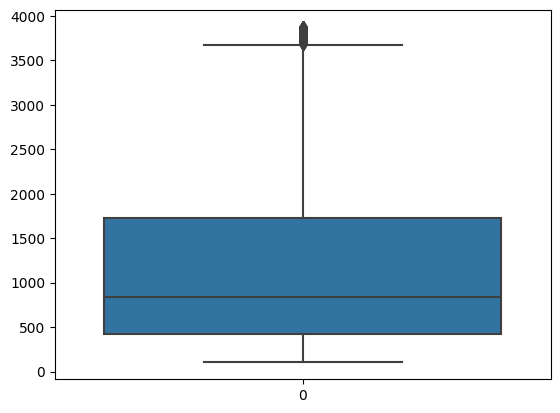

In [380]:
# Histogram
fig = px.histogram(new_dataset_flight_distance_3, x='Flight Distance')
fig.show()
# Box plot
sns.boxplot(new_dataset_flight_distance_3['Flight Distance'])
# Scatter plot
fig = px.scatter(x=new_dataset_flight_distance_3['Flight Distance'])
fig.show()

In [381]:
final_dataset = new_dataset_flight_distance

# Check the data type of our date column

In [382]:
#print(new_dataset_flight_distance)

In [383]:
# Display data types of all columns
data_types = final_dataset.dtypes
print(data_types)

Gender                    object
Customer Type             object
Age                        int64
Type of Travel            object
Flight Distance            int64
Ease of Online booking     int64
Seat comfort               int64
Inflight entertainment     int64
Baggage handling           int64
Checkin service            int64
satisfaction              object
dtype: object


# Numeric Encoding For Gender

In [384]:
unique_values = final_dataset['satisfaction'].unique()
print(unique_values)

['neutral or dissatisfied' 'satisfied' 'neutral or dissatisfied ']


In [385]:
# Define a mapping for the encoding
gender_mapping = {'Male': 0, 'Female': 1}
Customer_Type_mapping={'Loyal Customer':0, 'disloyal Customer':1}
Type_of_Travel_mapping ={'Personal Travel':0, 'Business travel':1}
satisfaction_mapping={'satisfied':1, 'neutral or dissatisfied':0}



# Create a new column 'Gender_Code' with numeric encoding
final_dataset['Gender_Code'] = final_dataset['Gender'].map(gender_mapping)

final_dataset = final_dataset.drop('Gender', axis=1)
# Rename the 'Gender_Code' column to 'Gender'
final_dataset = final_dataset.rename(columns={'Gender_Code': 'Gender'})




# Create a new column 'Customer_Type_Code' with numeric encoding
final_dataset['Customer Type_Code'] = final_dataset['Customer Type'].map(Customer_Type_mapping)

final_dataset = final_dataset.drop('Customer Type', axis=1)
# Rename the column 
final_dataset = final_dataset.rename(columns={'Customer Type_Code': 'Customer Type'})




# Create a new column 'Customer_Type_Code' with numeric encoding
final_dataset['Type of Travel_Code'] = final_dataset['Type of Travel'].map(Type_of_Travel_mapping)

final_dataset = final_dataset.drop('Type of Travel', axis=1)
# Rename the column 
final_dataset = final_dataset.rename(columns={'Type of Travel_Code': 'Type of Travel'})


# Create a new column 'satisfaction_Code' with numeric encoding
final_dataset['satisfaction_Code'] = final_dataset['satisfaction'].map(satisfaction_mapping)

final_dataset = final_dataset.drop('satisfaction', axis=1)
# Rename the column 
final_dataset = final_dataset.rename(columns={'satisfaction_Code': 'satisfaction'})




C:\Users\pariya\AppData\Local\Temp\ipykernel_4432\3867124537.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [386]:
print(final_dataset)
data_types = final_dataset.dtypes
print(data_types)

        Age  Flight Distance  Ease of Online booking  Seat comfort  \
0        13              460                       3             5   
1        25              235                       3             1   
2        26             1142                       2             5   
3        25              562                       5             2   
4        61              214                       3             5   
...     ...              ...                     ...           ...   
103899   23              192                       2             2   
103900   49             2347                       4             5   
103901   30             1995                       1             5   
103902   22             1000                       1             1   
103903   27             1723                       3             1   

        Inflight entertainment  Baggage handling  Checkin service  Gender  \
0                            5                 4                4       0   
1    

In [387]:
# Save the new dataset to a CSV file
final_dataset.to_csv("final_dataset.csv", index=False)

# Scaling vs. Normalization: What's the difference?
in scaling, you're changing the *range* of your data while in normalization you're changing the *shape of the distribution* of your data.

## **Scaling**
By scaling your variables, you can help compare different variables on equal footing.

In [388]:
## generate 1000 data points randomly drawn from an exponential distribution
#original_data = np.random.exponential(size = 1000)

## mix-max scale the data between 0 and 1
#scaled_data = minmax_scaling(original_data, columns = [0])

## plot both together to compare
#fig, ax=plt.subplots(1,2)
#sns.histplot(original_data, ax=ax[0])
#ax[0].set_title("Original Data")
#sns.histplot(scaled_data, ax=ax[1])
#ax[1].set_title("Scaled data")

In [389]:
# Min-Max Scaling

min_val = final_dataset['Flight Distance'].min()
max_val = final_dataset['Flight Distance'].max()

final_dataset['Flight Distance'] = (final_dataset['Flight Distance'] - min_val) / (max_val - min_val)

min_val2 = final_dataset['Age'].min()
max_val2 = final_dataset['Age'].max()

final_dataset['Age'] = (final_dataset['Age'] - min_val2) / (max_val2 - min_val2)



## Normalization

In [390]:
## normalize the exponential data with boxcox
#normalized_data = stats.boxcox(original_data)

## plot both together to compare
#fig, ax=plt.subplots(1,2)
#sns.histplot(original_data, ax=ax[0])
#ax[0].set_title("Original Data")
#sns.histplot(normalized_data[0], ax=ax[1])
#ax[1].set_title("Normalized data")

# Data Analysis

In [391]:
print(final_dataset.columns)

Index(['Age', 'Flight Distance', 'Ease of Online booking', 'Seat comfort',
       'Inflight entertainment', 'Baggage handling', 'Checkin service',
       'Gender', 'Customer Type', 'Type of Travel', 'satisfaction'],
      dtype='object')


In [392]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

class NeuralNetwork:
    def __init__(self, layer_sizes):
        self.layer_sizes = layer_sizes
        self.parameters = self.initialize_parameters()

    def initialize_parameters(self):
        parameters = {}
        for l in range(1, len(self.layer_sizes)):
            parameters['W' + str(l)] = np.random.randn(self.layer_sizes[l], self.layer_sizes[l-1]) * np.sqrt(2. / self.layer_sizes[l-1])
            parameters['b' + str(l)] = np.zeros((self.layer_sizes[l], 1))
        return parameters

    def relu(self, Z):
        return np.maximum(0, Z)
    
    def relu_derivative(self, Z):
        return Z > 0

    def sigmoid(self, Z):
        return np.where(Z >= 0, 
                        1 / (1 + np.exp(-Z)), 
                        np.exp(Z) / (1 + np.exp(Z)))
    

    def sigmoid_derivative(self, A):
        return np.clip(A, 1e-7, 1 - 1e-7) * (1 - np.clip(A, 1e-7, 1 - 1e-7))


    def forward(self, X):
        activations = {'A0': X}
        L = len(self.parameters) // 2

        for l in range(1, L):
            Z = np.dot(self.parameters['W' + str(l)], activations['A' + str(l-1)]) + self.parameters['b' + str(l)]
            activations['A' + str(l)] = self.relu(Z)

        Z = np.dot(self.parameters['W' + str(L)], activations['A' + str(L-1)]) + self.parameters['b' + str(L)]
        activations['A' + str(L)] = self.sigmoid(Z)

        return activations

    def backward(self, activations, Y):
        grads = {}
        L = len(self.parameters) // 2
        m = Y.shape[1]
        Y = Y.reshape(activations['A' + str(L)].shape)

        clipped_activations = np.clip(activations['A' + str(L)], 1e-7, 1 - 1e-7)
        dA = - (np.divide(Y, clipped_activations) - np.divide(1 - Y, 1 - clipped_activations))

        for l in reversed(range(1, L + 1)):
            if l == L:
                dZ = dA * self.sigmoid_derivative(activations['A' + str(l)])
            else:
                dZ = dA * self.relu_derivative(activations['A' + str(l)])

            dW = 1./m * np.dot(dZ, activations['A' + str(l-1)].T)
            db = 1./m * np.sum(dZ, axis=1, keepdims=True)
            if l > 1:
                dA = np.dot(self.parameters['W' + str(l)].T, dZ)

            grads['dW' + str(l)] = dW
            grads['db' + str(l)] = db

        return grads

    def update_parameters(self, grads, learning_rate):
        L = len(self.parameters) // 2
        for l in range(L):
            self.parameters['W' + str(l+1)] -= learning_rate * grads['dW' + str(l+1)]
            self.parameters['b' + str(l+1)] -= learning_rate * grads['db' + str(l+1)]

    def train(self, X, Y, learning_rate, iterations):
        self.losses = []  
        for _ in tqdm(range(iterations), desc='Training'):
            activations = self.forward(X)
            loss = self.cross_entropy_loss(Y, activations['A' + str(len(self.parameters) // 2)])
            self.losses.append(loss)
            grads = self.backward(activations, Y)
            self.update_parameters(grads, learning_rate)

    def predict(self, X):
        activations = self.forward(X)
        Y_pred = activations['A' + str(len(self.parameters) // 2)]
        Y_pred = np.where(Y_pred > 0.5, 1, 0)
        return Y_pred
    
    def accuracy(self, Y_pred, Y_test):
        return np.mean(Y_pred == Y_test)

    def cross_entropy_loss(self, Y, Y_pred):
        m = Y.shape[1]
        Y_pred = np.clip(Y_pred, 1e-7, 1 - 1e-7)  
        cost = -1/m * np.sum(Y * np.log(Y_pred) + (1 - Y) * np.log(1 - Y_pred))
        return np.squeeze(cost)

    def plot_loss(self):
        plt.plot(self.losses)
        plt.xlabel('Iteration')
        plt.ylabel('Loss')
        plt.show()

    def permutation_feature_importance(self, model, X, Y):
        baseline_metric = self.accuracy(model.predict(X), Y)
        feature_importance = []

        for col in range(X.shape[0]):  # Iterate over each feature
            save_col = X[col, :].copy()
            np.random.shuffle(X[col, :])  # Shuffle the feature values
            
            shuffled_metric = self.accuracy(model.predict(X), Y)
            feature_importance.append(baseline_metric - shuffled_metric)
            
            X[col, :] = save_col  # Restore original data

        return np.array(feature_importance)

Training: 100%|██████████| 1000/1000 [00:04<00:00, 203.84it/s]

Accuracy: 0.85


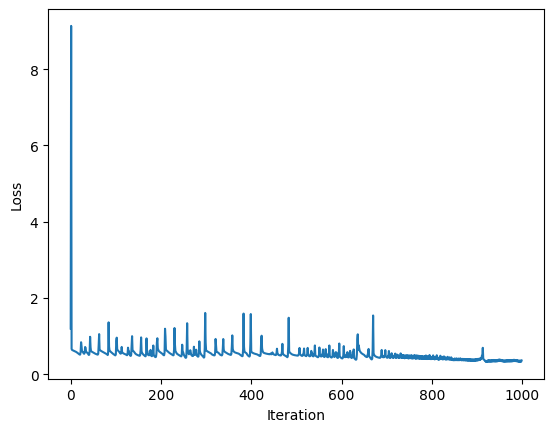

In [400]:
no_samples = 2000

sample = final_dataset.sample(no_samples)

train_size = int(0.8 * no_samples)


Y_train = sample['satisfaction'].to_numpy()[:train_size].reshape(1, -1)
Y_test = sample['satisfaction'].to_numpy()[train_size:].reshape(1, -1)

sample.drop(columns=['satisfaction'], inplace=True)

X = sample.to_numpy()

# Split it to 1600 training examples and 400 test examples
X_train = X[:train_size].T
X_test = X[train_size:].T

input_size = X_train.shape[0]  
hidden_size = 128
output_size = 1
learning_rate = 0.6
iterations = 1000

net = NeuralNetwork([input_size, hidden_size, output_size])
net.train(X_train, Y_train, learning_rate, iterations)


Y_pred = net.predict(X_test)


accuracy = net.accuracy(Y_pred, Y_test)
print(f"Accuracy: {accuracy:.2f}")


net.plot_loss()

result = pd.DataFrame({'Y_test': Y_test[0], 'Y_pred': Y_pred[0]})
result.to_csv('result.csv', index=False)



Training: 100%|██████████| 1000/1000 [00:10<00:00, 95.95it/s]


Accuracy: 0.86
Feature importances: [ 0.009  0.008  0.066  0.034  0.106  0.021  0.042 -0.002  0.081  0.158]
Feature importances in order:
Checkin service: 0.15800000000000003
Flight Distance: 0.10599999999999998
Baggage handling: 0.08099999999999996
Age: 0.06599999999999995
Seat comfort: 0.04200000000000004
Type of Travel: 0.03400000000000003
Ease of Online booking: 0.02100000000000002
Gender: 0.009000000000000008
Customer Type: 0.008000000000000007
Inflight entertainment: -0.0020000000000000018


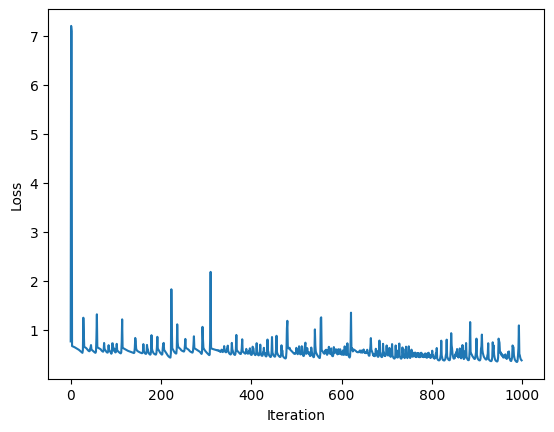

In [401]:
no_samples = 5000

sample = final_dataset.sample(no_samples)

train_size = int(0.8 * no_samples)


Y_train = sample['satisfaction'].to_numpy()[:train_size].reshape(1, -1)
Y_test = sample['satisfaction'].to_numpy()[train_size:].reshape(1, -1)

sample.drop(columns=['satisfaction'], inplace=True)

X = sample.to_numpy()

# Split it to 1600 training examples and 400 test examples
X_train = X[:train_size].T
X_test = X[train_size:].T

input_size = X_train.shape[0]  
hidden_size = 128
output_size = 1
learning_rate = 0.6
iterations = 1000

net = NeuralNetwork([input_size, hidden_size, output_size])
net.train(X_train, Y_train, learning_rate, iterations)


Y_pred = net.predict(X_test)


accuracy = net.accuracy(Y_pred, Y_test)
print(f"Accuracy: {accuracy:.2f}")


# Assess feature importance
feature_importances = net.permutation_feature_importance(net, X_test, Y_test)
print("Feature importances:", feature_importances)


feature_importance_pairs = list(zip(selected_columns, feature_importances))

sorted_feature_importance = sorted(feature_importance_pairs, key=lambda x: x[1], reverse=True)
print("Feature importances in order:")
for feature, importance in sorted_feature_importance:
    print(f"{feature}: {importance}")



net.plot_loss()


result = pd.DataFrame({'Y_test': Y_test[0], 'Y_pred': Y_pred[0]})
result.to_csv('result.csv', index=False)



In [395]:
import numpy as np
import pandas as pd

def entropy(df, X):
    p_data = df[X].value_counts() / len(df[X])  # Probability distribution
    entropy = -np.sum(p_data * np.log2(p_data))  # Entropy calculation
    return entropy

def conditional_entropy(df, X, Y):
    conditional_entropy = 0
    for value in df[X].dropna().unique():  # Handle NaN values
        df_subset = df[df[X] == value]
        p = len(df_subset) / len(df)
        conditional_entropy += p * entropy(df_subset, Y)
    return conditional_entropy

def information_gain(df, X, Y):
    return entropy(df, Y) - conditional_entropy(df, X, Y)

# Compute information gain for each feature
information_gain_list = []

#missing_values_count = new_dataset_flight_distance.isnull().sum()
#print(missing_values_count)

for column in new_dataset_flight_distance.columns[:-1]:
    ig = information_gain(new_dataset_flight_distance, column, 'satisfaction')
    information_gain_list.append(ig)

# Creating a Series for easy plotting and interpretation
information_gain_series = pd.Series(information_gain_list, index=new_dataset_flight_distance.columns[:-1])
information_gain_series.sort_values(ascending=False, inplace=True)

# Plotting
import plotly.express as px
fig = px.bar(x=information_gain_series.index, y=information_gain_series.values)
fig.show()
